In [ ]:
import  numpy  as  np
import  matplotlib.pyplot  as  plt
import  librosa
import  librosa.display
from  scipy.signal  import  firwin ,  lfilter
from  IPython.display  import  Audio ,  display

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

base_path = "/content/drive/MyDrive/audio_peesde/"

Mounted at /content/drive


In [ ]:
# Memuat file audio dari path folder, mengubahnya menjadi sinyal audio (audio_in) (audio_out) dan menyamakan sample rate ke 44.100 Hz
audio_in, sr_in = librosa.load(base_path + "rekaman indoor2.wav", sr=44100)  #rekaman indoor
audio_out, sr_out = librosa.load(base_path + "rekaman outdoor.wav", sr=44100) #rekaman outdoor

print("Sample Rate:", sr_in) # Menampilkan nilai sample rate audio untuk memastikan audio berhasil dimuat dengan sample rate yang sama
# Menghitung durasi audio indoor dan outdoor dengan membagi jumlah sampel audio dengan sample rate dalam satuan detik
print("Durasi Indoor:", len(audio_in)/sr_in, "detik")
print("Durasi Outdoor:", len(audio_out)/sr_out, "detik")

Sample Rate: 44100
Durasi Indoor: 15.31734693877551 detik
Durasi Outdoor: 15.384013605442178 detik


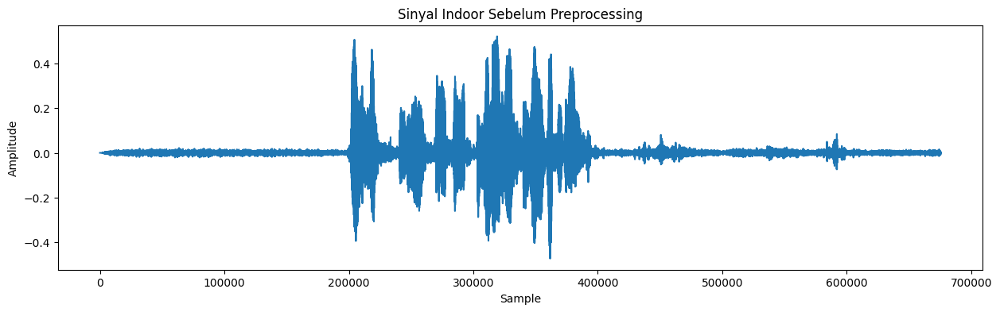

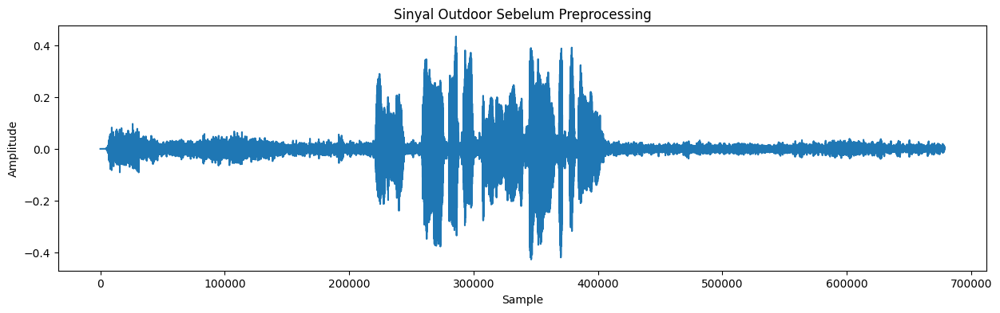

In [ ]:
#visualisasi sinyal audio indoor dan outdoor dalam domain waktu.
#Grafik menampilkan hubungan antara indeks sampel dan amplitudo sinyal sebelum dilakukan preprocessing
plt.figure(figsize=(15,4))
plt.plot(audio_in)
plt.title("Sinyal Indoor Sebelum Preprocessing")
plt.xlabel("Sample")
plt.ylabel("Amplitude")
plt.show()

plt.figure(figsize=(15,4))
plt.plot(audio_out)
plt.title("Sinyal Outdoor Sebelum Preprocessing")
plt.xlabel("Sample")
plt.ylabel("Amplitude")
plt.show()

In [ ]:
print("Audio Asli Indoor:")
Audio(audio_in, rate=sr_in)

Audio Asli Indoor:


In [ ]:
print("Audio Asli Outdoor:")
Audio(audio_out, rate=sr_out)

Audio Asli Outdoor:


PRE-PROCESSING

In [ ]:
def preprocess(audio):
  # Menghilangkan bagian hening (silence) pada awal dan akhir audio
  # top_db=20 artinya bagian audio dengan energi di bawah 20 dB dari puncak dianggap sebagai silence
    trimmed, _ = librosa.effects.trim(audio, top_db=20)
  # Melakukan normalisasi amplitudo agar nilai sinyal berada pada rentang -1 sampai 1
  # Tujuannya menyamakan skala amplitudo dan mencegah perbedaan volume memengaruhi analisis
    normalized = trimmed / np.max(np.abs(trimmed))
    return normalized # Mengembalikan sinyal audio yang sudah dipotong dan di normalisasi

audio_in_p = preprocess(audio_in)
audio_out_p = preprocess(audio_out)

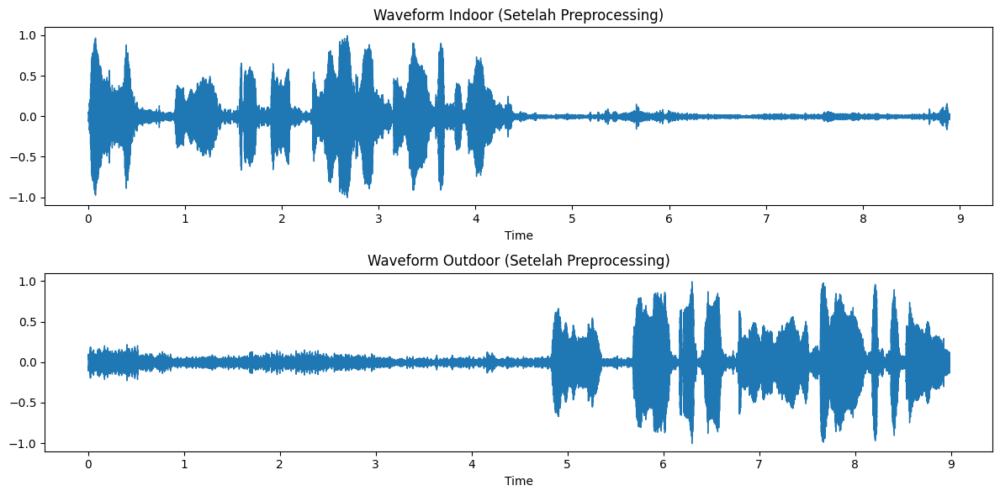

In [ ]:
#Menampilkan grafik setalah di lakukan preprocessing
plt.figure(figsize=(12,6))
plt.subplot(2,1,1)
librosa.display.waveshow(audio_in_p, sr=sr_in)
plt.title("Waveform Indoor (Setelah Preprocessing)")

plt.subplot(2,1,2)
librosa.display.waveshow(audio_out_p, sr=sr_out)
plt.title("Waveform Outdoor (Setelah Preprocessing)")

plt.tight_layout()
plt.show()

In [ ]:
print("Indoor Setelah Preprocessing:")
Audio(audio_in_p, rate=sr_in)

Indoor Setelah Preprocessing:


In [ ]:
print("Outdoor Setelah Preprocessing:")
Audio(audio_out_p, rate=sr_out)

Outdoor Setelah Preprocessing:


hasil dari pre-processing:
1. Waveform menunjukkan audio sudah dipotong bagian heningnya
2. Amplitudo berada pada rentang -1 sampai 1 → tanda normalisasi berhasil
3. Perbedaan pola indoor dan outdoor terlihat jelas setelah preprocessing

MOVING AVERAGE

In [ ]:
def moving_average(signal, window):
   # Membuat filter berupa array bernilai sama
    # Total bobot = 1, sehingga amplitudo sinyal tetap terjaga
    kernel = np.ones(window) / window
    return np.convolve(signal, kernel, mode='same') # mode='same' menjaga panjang output sama dengan sinyal input

# Window yang di uji 100,200,300
# Semakin besar window, semakin halus sinyal tetapi detail cepat akan hilang
ma_windows = [100, 200, 300]

# Hasil MA kita simpan di dictionary
ma_in  = {}
ma_out = {}

for w in ma_windows:
    ma_in[w]  = moving_average(audio_in_p,  w)   # indoor
    ma_out[w] = moving_average(audio_out_p, w)   # outdoor

print("Moving Average selesai untuk window:", ma_windows)

Moving Average selesai untuk window: [100, 200, 300]


In [ ]:
print("Audio Indoor – Hasil Moving Average")
for w in ma_windows:
    print(f"Indoor – MA window {w}")
    display(Audio(ma_in[w], rate=sr_in))



Audio Indoor – Hasil Moving Average
Indoor – MA window 100


Indoor – MA window 200


Indoor – MA window 300


In [ ]:
print("Audio Outdoor – Hasil Moving Average")
for w in ma_windows:
    print(f"Outdoor – MA window {w}")
    display(Audio(ma_out[w], rate=sr_out))

Audio Outdoor – Hasil Moving Average
Outdoor – MA window 100


Outdoor – MA window 200


Outdoor – MA window 300


In [ ]:
# Durasi segmen yang mau ditampilkan
segment_dur = 0.3  # detik
N_out = int(segment_dur * sr_out)

# Potong sinyal asli dan MA ke 0–0.3 detik
seg_out_asli = audio_out_p[:N_out]

seg_out_ma = {w: ma_out[w][:N_out] for w in ma_windows}

# Waktu untuk sumbu x
t_seg_out = np.arange(N_out) / sr_out


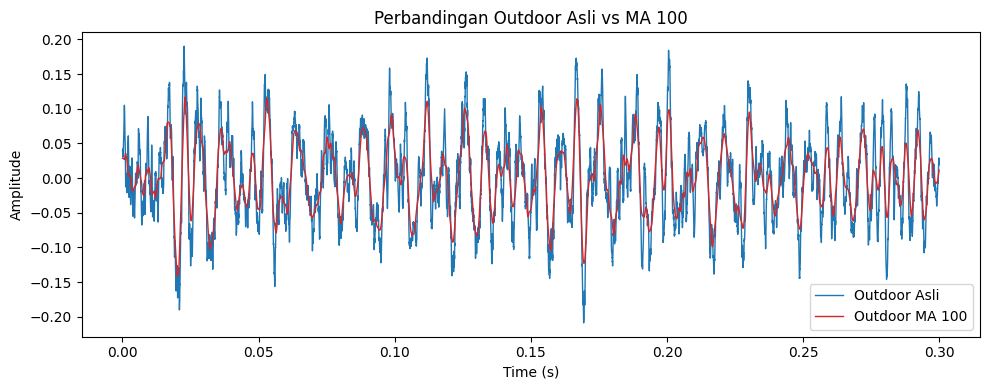

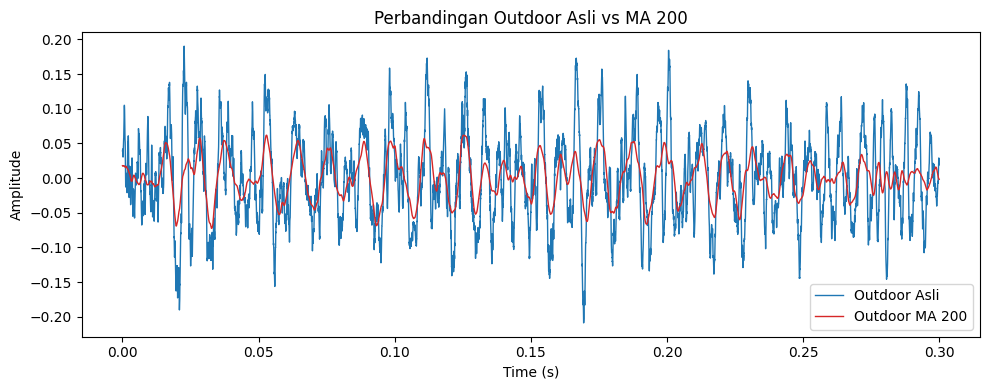

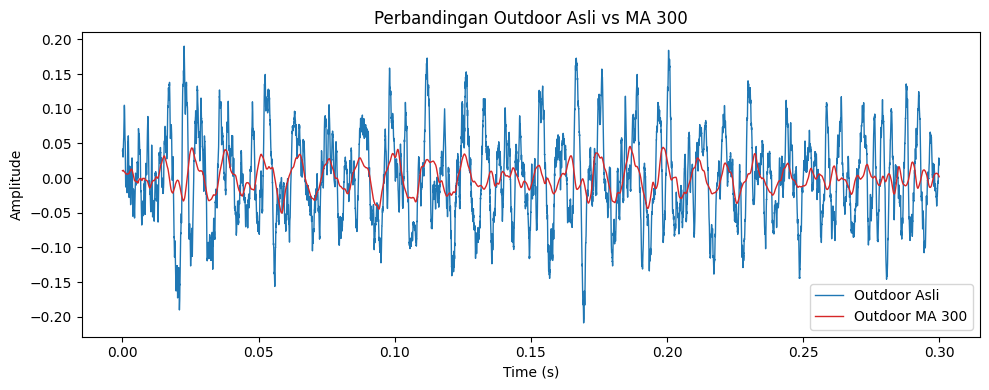

In [ ]:
for w in ma_windows:
    plt.figure(figsize=(10,4))

    # Sinyal asli (biru)
    plt.plot(t_seg_out, seg_out_asli, label="Outdoor Asli", color="tab:blue", linewidth=1)
    # Hasil MA (merah)
    plt.plot(t_seg_out, seg_out_ma[w], label=f"Outdoor MA {w}", color="tab:red", linewidth=1)

    plt.title(f"Perbandingan Outdoor Asli vs MA {w}")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.tight_layout()
    plt.show()


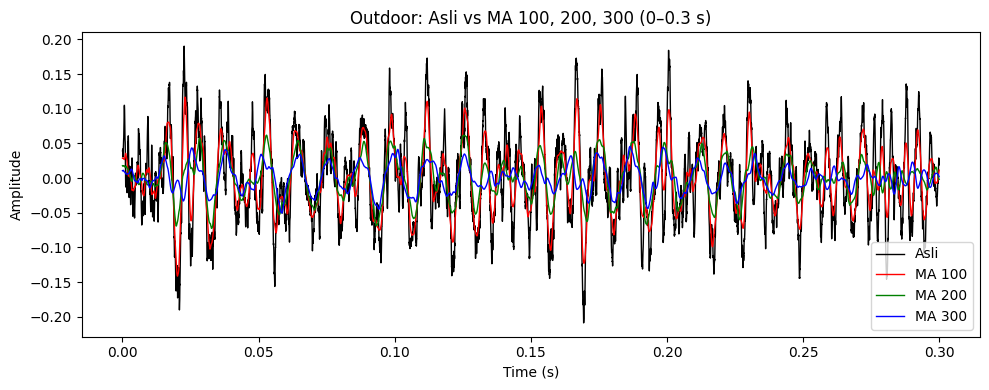

In [ ]:
# Segment 0–0.3 detik untuk OUTDOOR
segment_dur = 0.3   # detik
N_out = int(segment_dur * sr_out)

t_seg_out      = np.arange(N_out) / sr_out
seg_out_asli   = audio_out_p[:N_out]
seg_out_ma100  = ma_out[100][:N_out]
seg_out_ma200  = ma_out[200][:N_out]
seg_out_ma300  = ma_out[300][:N_out]

plt.figure(figsize=(10,4))

plt.plot(t_seg_out, seg_out_asli,  label="Asli",   color="black", linewidth=1.0)
plt.plot(t_seg_out, seg_out_ma100, label="MA 100", color="red",   linewidth=1.0)
plt.plot(t_seg_out, seg_out_ma200, label="MA 200", color="green", linewidth=1.0)
plt.plot(t_seg_out, seg_out_ma300, label="MA 300", color="blue",  linewidth=1.0)

plt.title("Outdoor: Asli vs MA 100, 200, 300 (0–0.3 s)")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.legend()
plt.tight_layout()
plt.show()


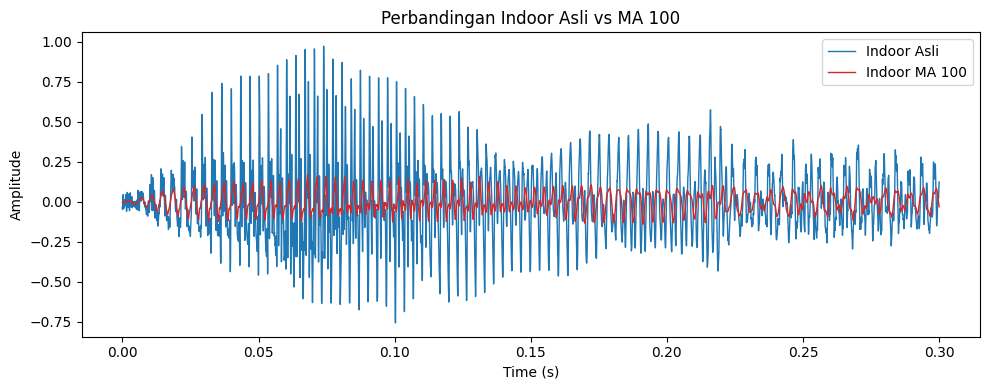

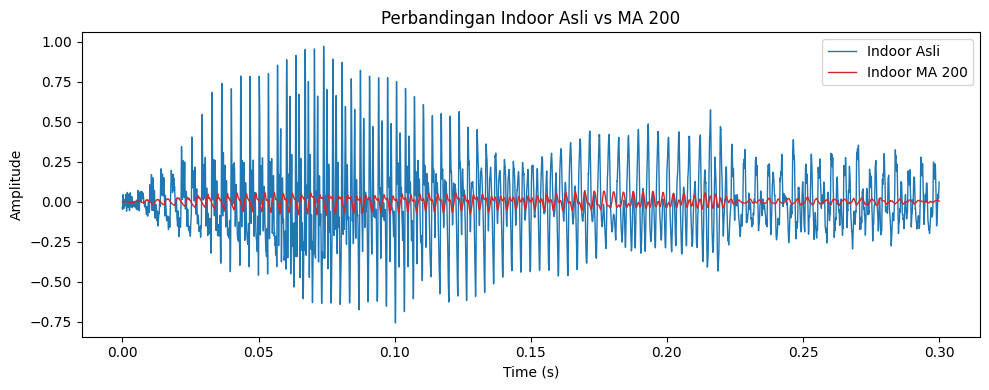

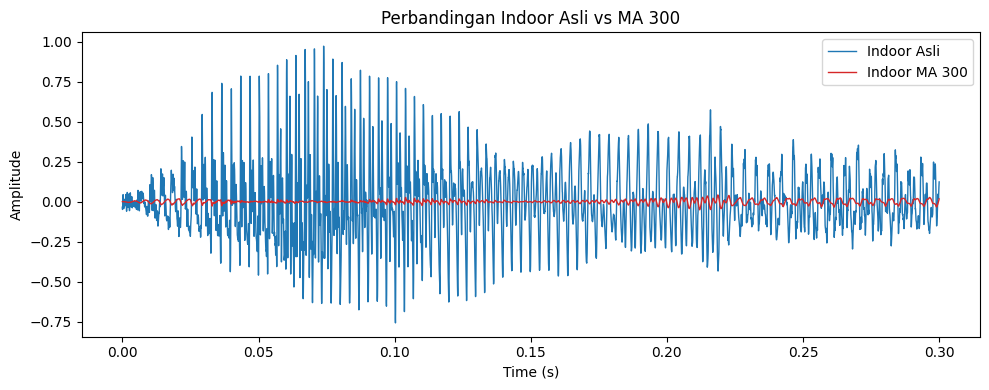

In [ ]:
segment_dur = 0.3
N_in = int(segment_dur * sr_in)

seg_in_asli = audio_in_p[:N_in]
seg_in_ma = {w: ma_in[w][:N_in] for w in ma_windows}
t_seg_in = np.arange(N_in) / sr_in

for w in ma_windows:
    plt.figure(figsize=(10,4))
    plt.plot(t_seg_in, seg_in_asli, label="Indoor Asli", color="tab:blue", linewidth=1)
    plt.plot(t_seg_in, seg_in_ma[w], label=f"Indoor MA {w}", color="tab:red", linewidth=1)
    plt.title(f"Perbandingan Indoor Asli vs MA {w}")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.tight_layout()
    plt.show()


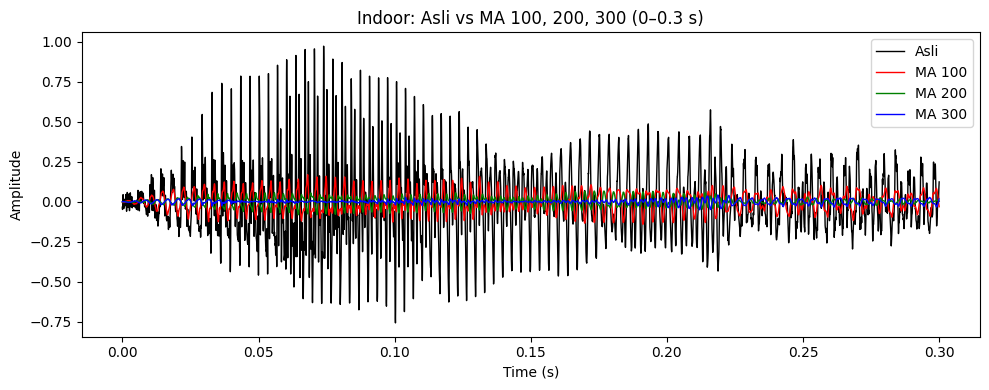

In [ ]:
# Segment 0–0.3 detik untuk INDOOR
segment_dur = 0.3   # detik
N_in = int(segment_dur * sr_in)

t_seg_in      = np.arange(N_in) / sr_in
seg_in_asli   = audio_in_p[:N_in]
seg_in_ma100  = ma_in[100][:N_in]
seg_in_ma200  = ma_in[200][:N_in]
seg_in_ma300  = ma_in[300][:N_in]

plt.figure(figsize=(10,4))

plt.plot(t_seg_in, seg_in_asli,  label="Asli",   color="black", linewidth=1.0)
plt.plot(t_seg_in, seg_in_ma100, label="MA 100", color="red",   linewidth=1.0)
plt.plot(t_seg_in, seg_in_ma200, label="MA 200", color="green", linewidth=1.0)
plt.plot(t_seg_in, seg_in_ma300, label="MA 300", color="blue",  linewidth=1.0)

plt.title("Indoor: Asli vs MA 100, 200, 300 (0–0.3 s)")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.legend()
plt.tight_layout()
plt.show()


In [ ]:
# Pilihan terbaik untuk lanjut ke filter: MA window 200
den_in  = ma_in[200]   # indoor setelah MA-200
den_out = ma_out[200]  # outdoor setelah MA-200


Hasil dari moving average pada sinyal audio:
Penerapan moving average dengan berbagai ukuran window menunjukkan bahwa window berukuran 200 memberikan hasil paling seimbang antara penghalusan sinyal dan pelestarian detail amplitudo. Window yang lebih kecil kurang efektif dalam meredam noise, sedangkan window yang lebih besar menyebabkan sinyal menjadi terlalu halus dan kehilangan informasi penting. Oleh karena itu, moving average dengan window 200 dipilih sebagai parameter terbaik untuk tahap preprocessing.

FILTER

In [ ]:
# Cell ini digunakan untuk mendefinisikan fungsi Fast Fourier Transform (FFT)
# bertujuan mengubah sinyal audio dari domain waktu ke domain frekuensi guna menganalisis kandungan frekuensi sinyal.
import numpy as np
import matplotlib.pyplot as plt

def compute_fft(signal, sr):
    N = len(signal)
    fft = np.abs(np.fft.rfft(signal))          # magnitudo
    freq = np.fft.rfftfreq(N, 1/sr)           # sumbu frekuensi
    return freq, fft


In [ ]:
# Cell ini digunakan untuk menerapkan filter FIR bandpass (500–1500 Hz) pada sinyal audio
# menggunakan beberapa jenis window (Blackman, Hamming, Hann, Boxcar).

windows_fir = ["blackman", "hamming", "hann", "boxcar"]

# Parameter filter bandpass
cutoff_low  = 500    # Frekuensi batas bawah filter (Hz)
cutoff_high = 1500   # Frekuensi batas atas filter (Hz)
numtaps     = 401    # orde FIR

filtered_in  = {}
filtered_out = {}

for w in windows_fir:
    # Desain filter FIR bandpass 500–1500 Hz dengan window w
    fir = firwin(
        numtaps,
        [cutoff_low, cutoff_high],
        pass_zero=False,
        window=w,
        fs=sr_in
    )

    # Terapkan ke sinyal indoor & outdoor (input = MA 200)
    filtered_in[w]  = lfilter(fir, 1.0, den_in)
    filtered_out[w] = lfilter(fir, 1.0, den_out)

print("Filtering selesai untuk window:", windows_fir)


Filtering selesai untuk window: ['blackman', 'hamming', 'hann', 'boxcar']


In [ ]:
print("Audio Indoor – Hasil Filter")
for w in windows_fir:
    print(f"Indoor – Filter {w}")
    display(Audio(filtered_in[w], rate=sr_in))

Audio Indoor – Hasil Filter
Indoor – Filter blackman


Indoor – Filter hamming


Indoor – Filter hann


Indoor – Filter boxcar


In [ ]:
print("Audio Outdoor – Hasil Filter")
for w in windows_fir:
    print(f"Outdoor – Filter {w}")
    display(Audio(filtered_out[w], rate=sr_out))

Audio Outdoor – Hasil Filter
Outdoor – Filter blackman


Outdoor – Filter hamming


Outdoor – Filter hann


Outdoor – Filter boxcar


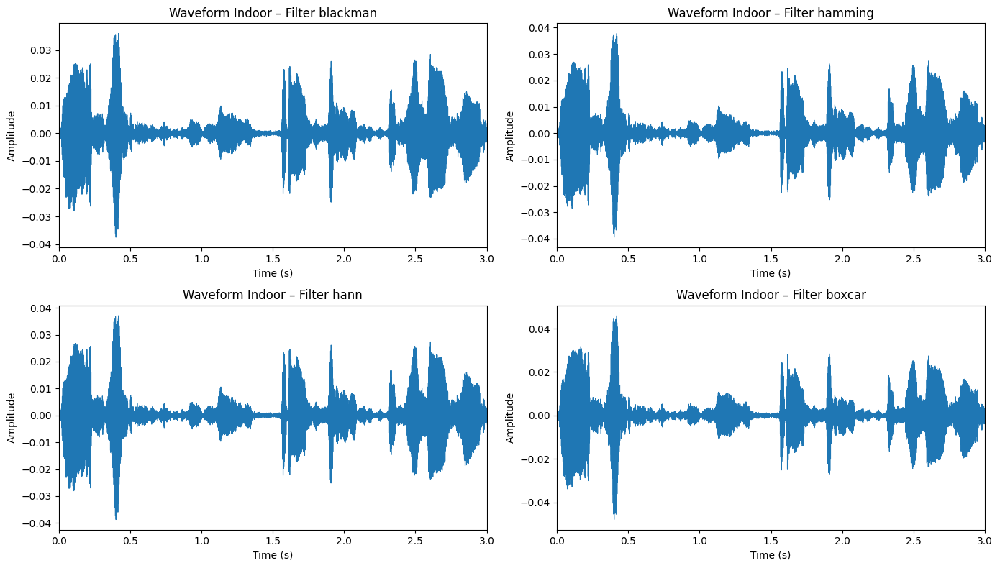

In [ ]:
# waktu untuk indoor (pakai sinyal MA-200 / den_in)
t_in = np.arange(len(den_in)) / sr_in

plt.figure(figsize=(14, 8))

for i, w in enumerate(windows_fir, 1):
    plt.subplot(2, 2, i)
    plt.plot(t_in, filtered_in[w], linewidth=0.8)
    plt.xlim(0, 3)  # fokus 3 detik pertama
    plt.title(f"Waveform Indoor – Filter {w}")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")

plt.tight_layout()
plt.show()


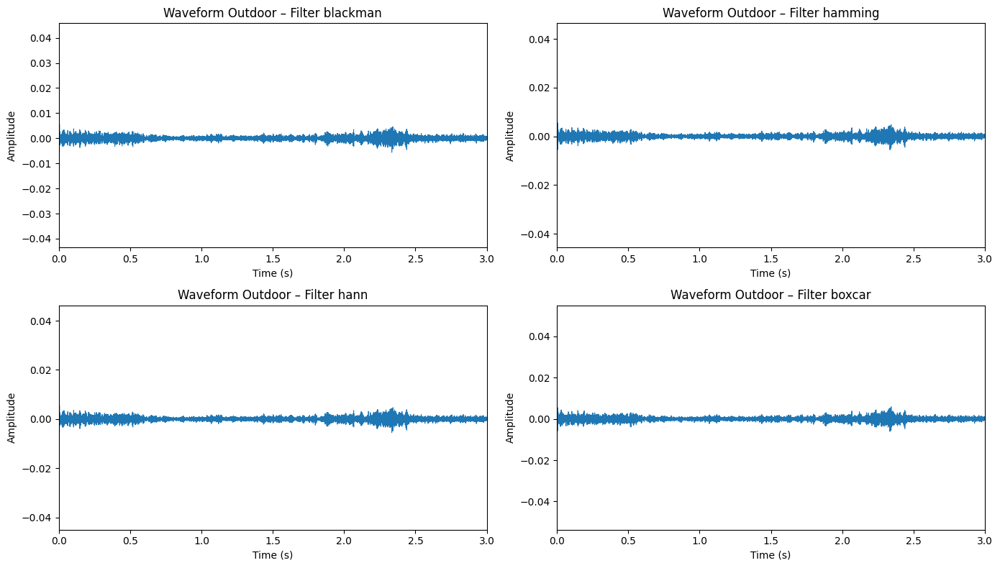

In [ ]:
# waktu untuk outdoor (pakai sinyal MA-200 / den_out)
t_out = np.arange(len(den_out)) / sr_out

plt.figure(figsize=(14, 8))

for i, w in enumerate(windows_fir, 1):
    plt.subplot(2, 2, i)
    plt.plot(t_out, filtered_out[w], linewidth=0.8)
    plt.xlim(0, 3)  # fokus 3 detik pertama
    plt.title(f"Waveform Outdoor – Filter {w}")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")

plt.tight_layout()
plt.show()


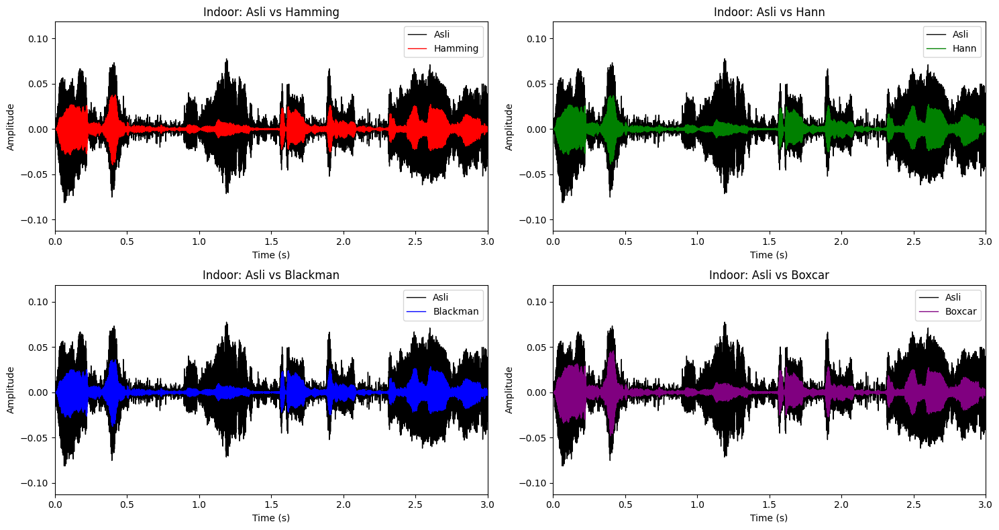

In [ ]:
#Grafik perbandingan audio asli indoor dengan audio indoor setelah di filter
t_in = np.arange(len(den_in)) / sr_in
filter_names = ["hamming", "hann", "blackman", "boxcar"]
filter_titles = ["Hamming", "Hann", "Blackman", "Boxcar"]
colors = ["red", "green", "blue", "purple"]

plt.figure(figsize=(15,8))

for i, (fname, title, col) in enumerate(zip(filter_names, filter_titles, colors), 1):
    plt.subplot(2, 2, i)
    plt.plot(t_in, den_in, label="Asli", color="black", linewidth=1)
    plt.plot(t_in, filtered_in[fname], label=title, color=col, linewidth=1)
    plt.xlim(0, 3)
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.title(f"Indoor: Asli vs {title}")
    plt.legend()

plt.tight_layout()
plt.show()


/tmp/ipython-input-3787143548.py:17: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()


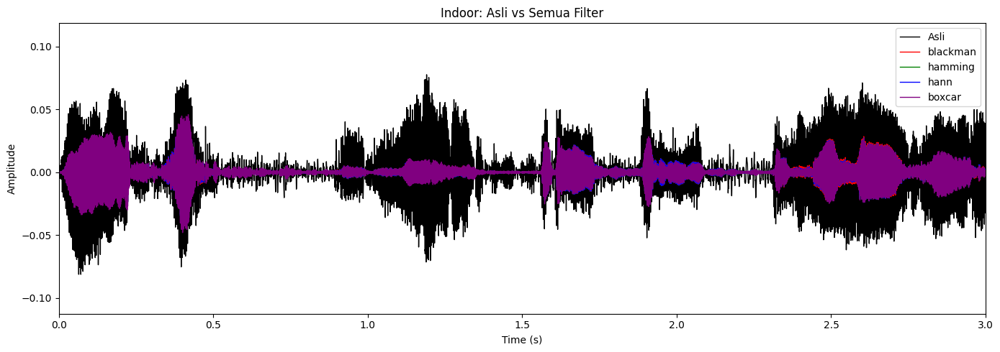

In [ ]:
plt.figure(figsize=(14,5))

# waktu untuk sinyal asli
t_asli = np.arange(len(den_in)) / sr_in
plt.plot(t_asli, den_in, label="Asli", color="black", linewidth=1)

# plot hasil filter
for w, c in zip(windows_fir, ["red", "green", "blue", "purple"]):
    t_filt = np.arange(len(filtered_in[w])) / sr_in
    plt.plot(t_filt, filtered_in[w], label=w, linewidth=1, color=c)

plt.xlim(0, 3)
plt.title("Indoor: Asli vs Semua Filter")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.legend()
plt.tight_layout()
plt.show()


Hasil dari filter audio indoor :
Filter FIR dengan window Hamming dan Hann memberikan hasil paling seimbang antara pengurangan noise dan pelestarian sinyal. Window Blackman paling efektif meredam noise, sedangkan Boxcar menunjukkan performa paling rendah.

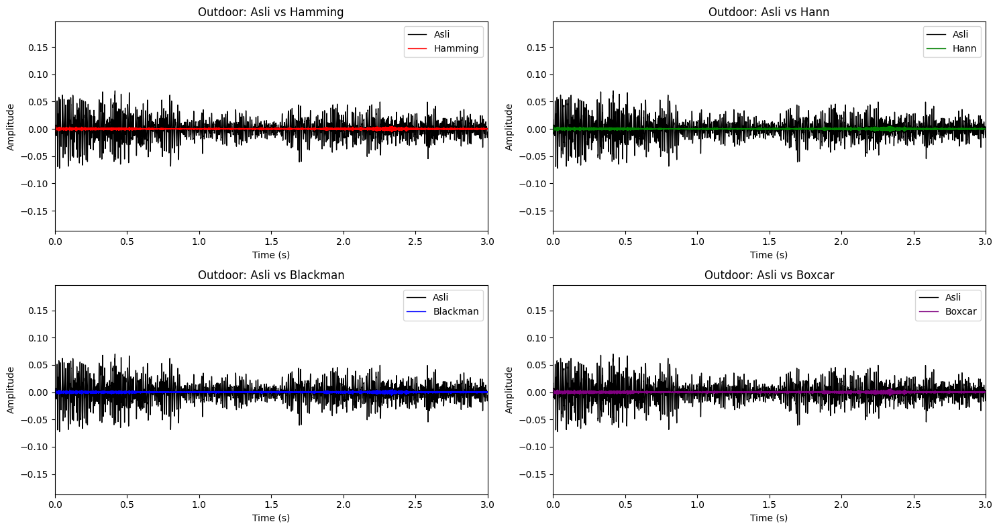

In [ ]:
# Grafik perbandingan audio asli outdoor dengan audio indoor setelah di filter
t_out = np.arange(len(den_out)) / sr_out
filter_names = ["hamming", "hann", "blackman", "boxcar"]
filter_titles = ["Hamming", "Hann", "Blackman", "Boxcar"]
colors = ["red", "green", "blue", "purple"]

plt.figure(figsize=(15,8))

for i, (fname, title, col) in enumerate(zip(filter_names, filter_titles, colors), 1):
    plt.subplot(2, 2, i)
    plt.plot(t_out, den_out, label="Asli", color="black", linewidth=1)
    plt.plot(t_out, filtered_out[fname], label=title, color=col, linewidth=1)
    plt.xlim(0, 3)
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.title(f"Outdoor: Asli vs {title}")
    plt.legend()

plt.tight_layout()
plt.show()


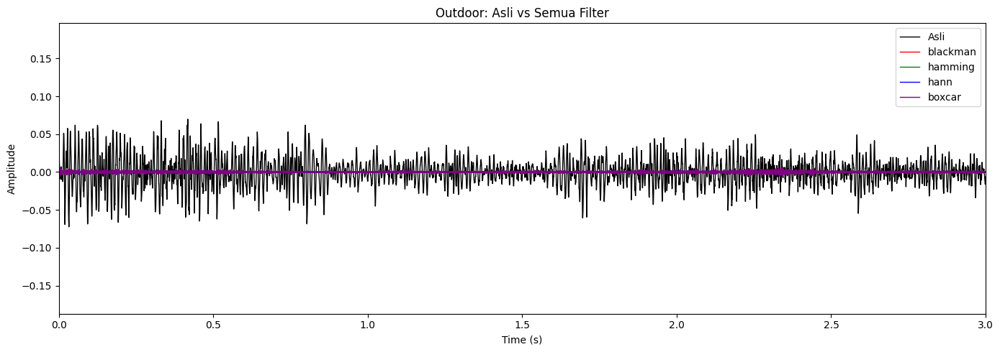

In [ ]:
plt.figure(figsize=(14,5))
t = np.arange(len(den_out)) / sr_out

plt.plot(t, den_out, label="Asli", color="black", linewidth=1)

for w, c in zip(windows_fir, ["red","green","blue","purple"]):
    plt.plot(t, filtered_out[w], label=w, linewidth=1, color=c)

plt.xlim(0, 3)
plt.title("Outdoor: Asli vs Semua Filter")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.legend()
plt.tight_layout()
plt.show()


Hasil dari filter audio outdoor:
Filter FIR dengan window Hamming dan Hann mampu meredam noise secara signifikan, namun menyebabkan amplitudo sinyal menjadi sangat kecil. Window Blackman memberikan peredaman noise paling agresif hingga hampir menghilangkan seluruh sinyal, sedangkan window Boxcar menunjukkan kemampuan peredaman yang paling rendah dan masih menyisakan noise.

FFT

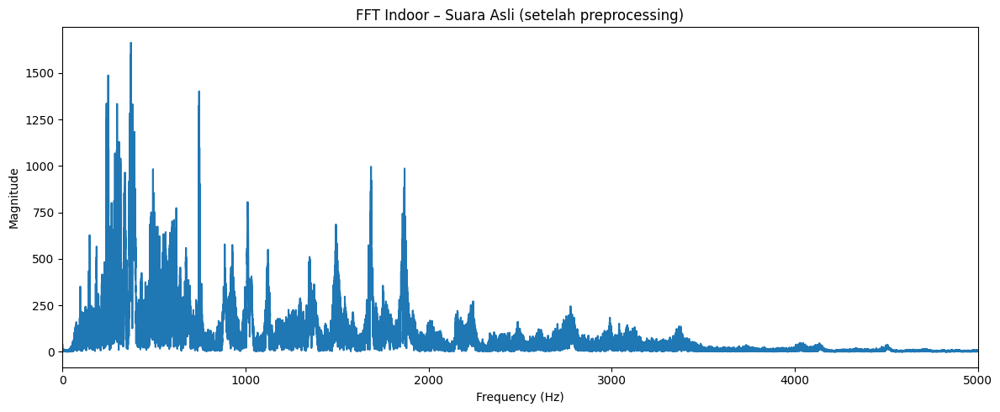

In [ ]:
#FT Indoor – Suara Asli (setelah preprocess)
freq_in_ori, fft_in_ori = compute_fft(audio_in_p, sr_in)

plt.figure(figsize=(12,5))
plt.plot(freq_in_ori, fft_in_ori)
plt.xlim(0, 5000)          # fokus 0–5000 Hz
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.title("FFT Indoor – Suara Asli (setelah preprocessing)")
plt.tight_layout()
plt.show()


Hasil FFT pada audio indoor setelah preprocessing menunjukkan bahwa energi sinyal terkonsentrasi pada frekuensi rendah hingga menengah, dengan puncak magnitudo yang jelas di bawah 2000 Hz. Hal ini merupakan karakteristik umum suara manusia, sehingga pemilihan filter bandpass 500–1500 Hz dinilai sesuai untuk mengekstraksi komponen penting dari sinyal indoor

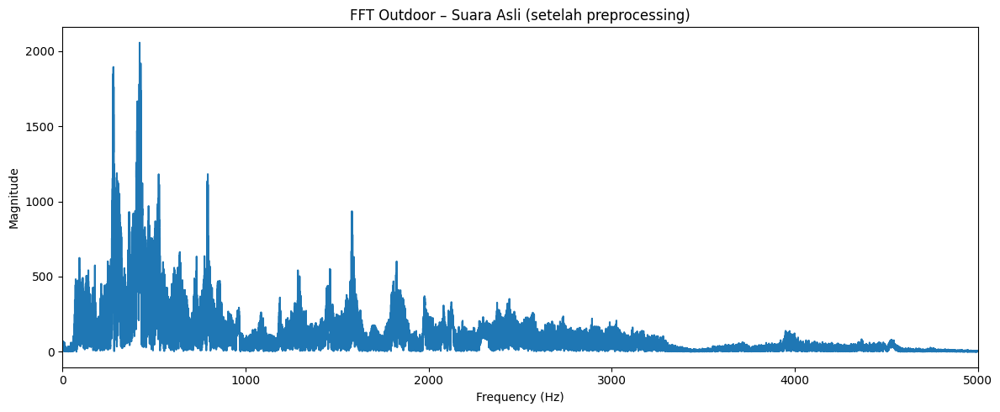

In [ ]:
#FFT Outdoor – Suara Asli (setelah preprocess)
freq_out_ori, fft_out_ori = compute_fft(audio_out_p, sr_out)

plt.figure(figsize=(12,5))
plt.plot(freq_out_ori, fft_out_ori)
plt.xlim(0, 5000)          # fokus 0–5000 Hz
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.title("FFT Outdoor – Suara Asli (setelah preprocessing)")
plt.tight_layout()
plt.show()


Hasil FFT pada audio outdoor setelah preprocessing menunjukkan sebaran energi frekuensi yang luas tanpa adanya puncak dominan. Hal ini mengindikasikan bahwa sinyal outdoor didominasi oleh noise lingkungan dengan karakteristik spektrum yang acak, sehingga penggunaan filter bandpass sempit kurang efektif untuk mempertahankan informasi sinyal.

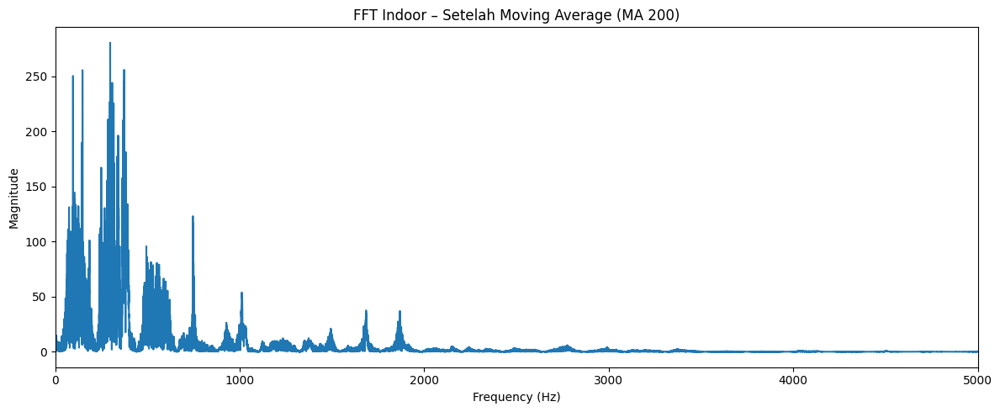

In [ ]:
# FFT INDOOR – SETELAH MOVING AVERAGE (MA 200)
freq_in_ma, fft_in_ma = compute_fft(den_in, sr_in)

plt.figure(figsize=(12,5))
plt.plot(freq_in_ma, fft_in_ma)
plt.xlim(0, 5000)
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.title("FFT Indoor – Setelah Moving Average (MA 200)")
plt.tight_layout()
plt.show()



Hasil FFT audio indoor setelah penerapan moving average dengan window 200 menunjukkan penurunan signifikan pada komponen frekuensi tinggi yang bersifat noise, sementara komponen frekuensi utama tetap terjaga. Hal ini menandakan bahwa MA 200 efektif sebagai tahap preprocessing untuk menghaluskan sinyal tanpa menghilangkan informasi penting.

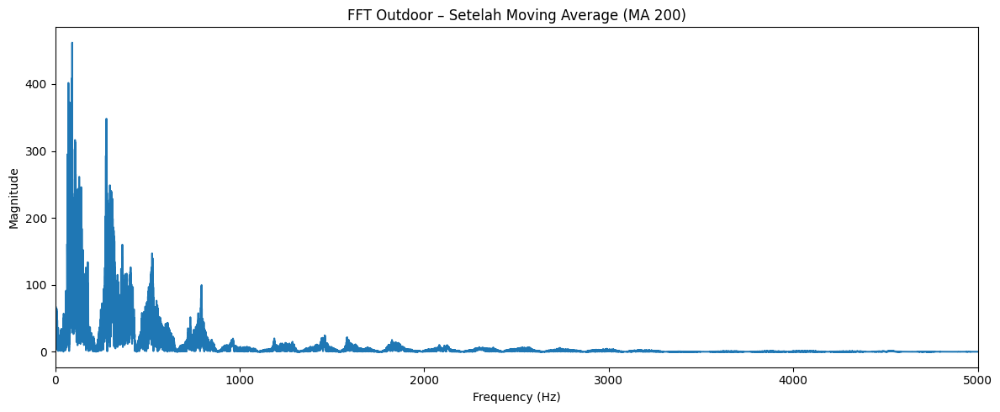

In [ ]:
# FFT OUTDOOR – SETELAH MOVING AVERAGE (MA 200)
freq_out_ma, fft_out_ma = compute_fft(den_out, sr_out)

plt.figure(figsize=(12,5))
plt.plot(freq_out_ma, fft_out_ma)
plt.xlim(0, 5000)
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.title("FFT Outdoor – Setelah Moving Average (MA 200)")
plt.tight_layout()
plt.show()


Hasil FFT pada audio outdoor setelah penerapan moving average dengan window 200 menunjukkan penurunan komponen frekuensi tinggi yang bersifat noise, namun tidak menghasilkan puncak frekuensi dominan. Hal ini mengindikasikan bahwa sinyal outdoor tetap didominasi oleh noise lingkungan, meskipun spektrum menjadi lebih halus setelah preprocessing.

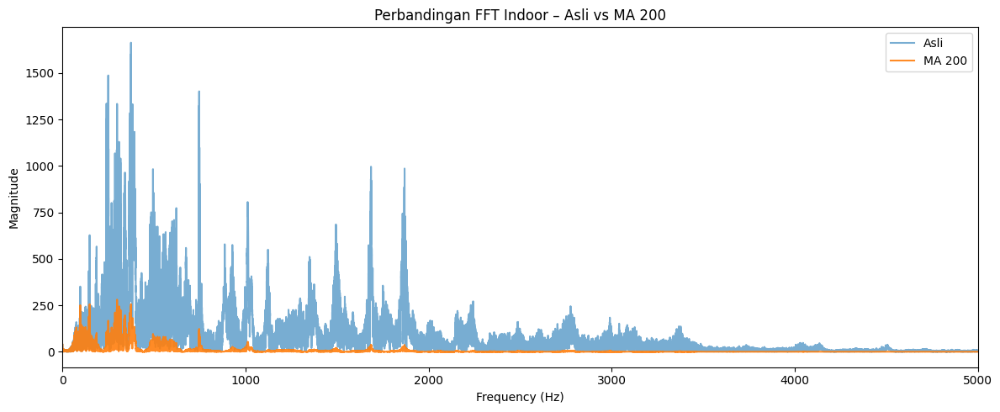

In [ ]:
# FFT Indoor: Asli vs MA 200
freq_in_ori, fft_in_ori = compute_fft(audio_in_p, sr_in)

plt.figure(figsize=(12,5))
plt.plot(freq_in_ori, fft_in_ori, label="Asli",  alpha=0.6)
plt.plot(freq_in_ma,  fft_in_ma,  label="MA 200", alpha=0.9)
plt.xlim(0, 5000)
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.title("Perbandingan FFT Indoor – Asli vs MA 200")
plt.legend()
plt.tight_layout()
plt.show()


Perbandingan FFT sinyal indoor asli dan sinyal setelah moving average window 200 menunjukkan penurunan magnitudo yang signifikan pada hampir seluruh rentang frekuensi, khususnya pada komponen yang bersifat noise. Meskipun demikian, pola frekuensi utama tetap terjaga, sehingga moving average MA 200 dinilai efektif sebagai tahap preprocessing.

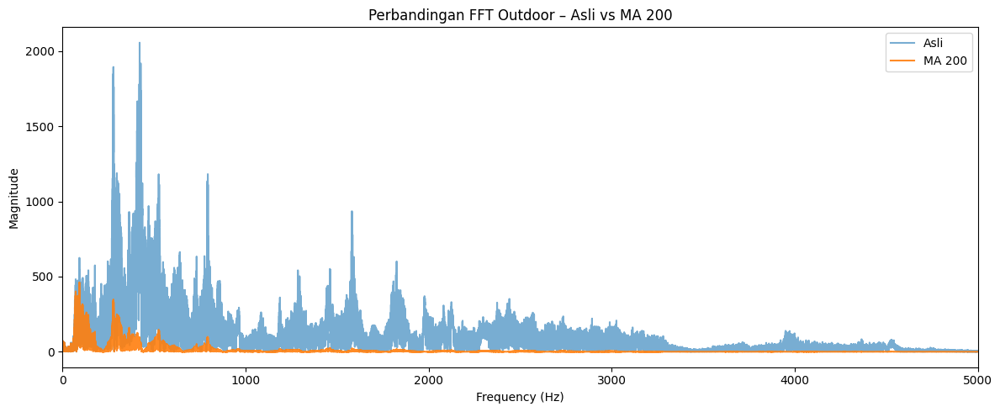

In [ ]:
# FFT Outdoor: Asli vs MA 200
freq_out_ori, fft_out_ori = compute_fft(audio_out_p, sr_out)

plt.figure(figsize=(12,5))
plt.plot(freq_out_ori, fft_out_ori, label="Asli",  alpha=0.6)
plt.plot(freq_out_ma,  fft_out_ma,  label="MA 200", alpha=0.9)
plt.xlim(0, 5000)
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.title("Perbandingan FFT Outdoor – Asli vs MA 200")
plt.legend()
plt.tight_layout()
plt.show()


Perbandingan FFT sinyal outdoor asli dan sinyal setelah moving average window 200 menunjukkan penurunan magnitudo spektrum yang signifikan di seluruh rentang frekuensi. Meskipun spektrum menjadi lebih halus, tidak muncul frekuensi dominan yang merepresentasikan sinyal utama, sehingga sinyal outdoor tetap didominasi oleh noise lingkungan.

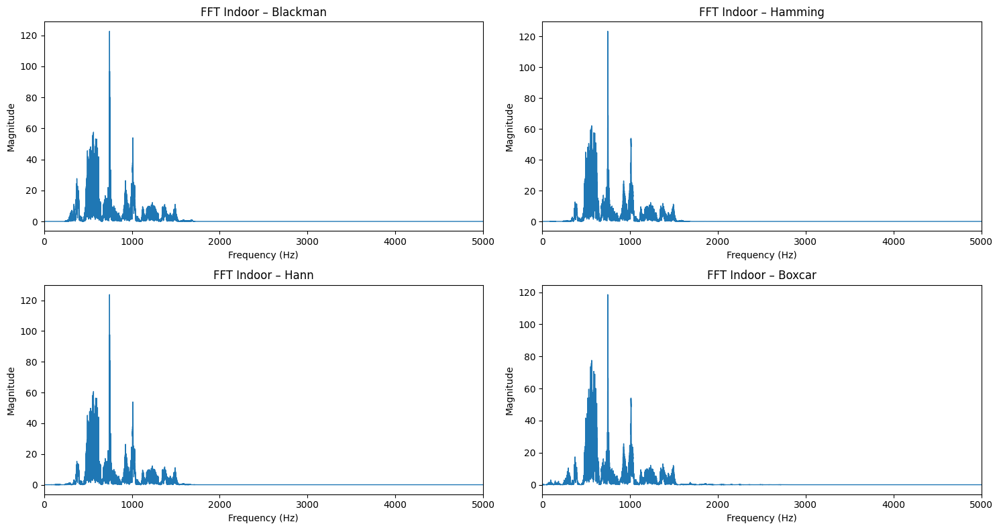

In [ ]:
# FFT FILTER INDOOR (2×2)

titles = {
    "hamming":  "Hamming",
    "hann":     "Hann",
    "blackman": "Blackman",
    "boxcar":   "Boxcar"
}

plt.figure(figsize=(15,8))

for i, w in enumerate(windows_fir, 1):
    freq_filt, fft_filt = compute_fft(filtered_in[w], sr_in)

    plt.subplot(2, 2, i)
    plt.plot(freq_filt, fft_filt, linewidth=1)
    plt.xlim(0, 5000)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.title(f"FFT Indoor – {titles[w]}")

plt.tight_layout()
plt.show()


Hasil FFT audio indoor setelah filtering FIR menunjukkan bahwa window Hamming dan Hann memberikan keseimbangan terbaik antara peredaman noise dan pelestarian komponen frekuensi utama. Window Blackman menghasilkan spektrum paling halus dengan peredaman noise tertinggi, namun mengurangi energi sinyal, sedangkan window Boxcar menunjukkan performa paling rendah akibat kebocoran frekuensi yang lebih besar.

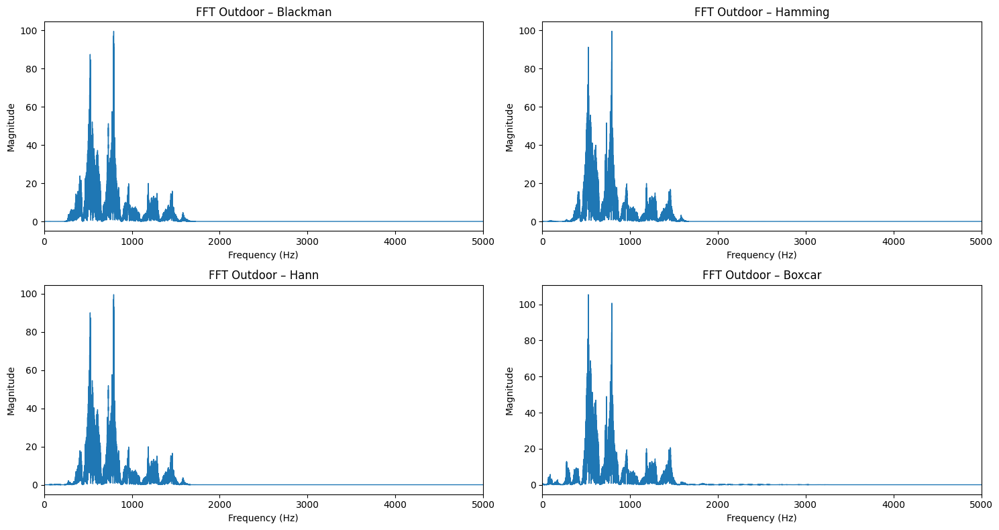

In [ ]:
# FFT FILTER OUTDOOR (2×2)

plt.figure(figsize=(15,8))

for i, w in enumerate(windows_fir, 1):
    freq_filt, fft_filt = compute_fft(filtered_out[w], sr_out)

    plt.subplot(2, 2, i)
    plt.plot(freq_filt, fft_filt, linewidth=1)
    plt.xlim(0, 5000)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.title(f"FFT Outdoor – {titles[w]}")

plt.tight_layout()
plt.show()


Hasil FFT audio outdoor setelah filtering FIR menunjukkan bahwa seluruh window menghasilkan spektrum dengan magnitudo rendah, menandakan peredaman sinyal yang kuat. Window Blackman memberikan peredaman paling agresif, sedangkan Boxcar menunjukkan kebocoran frekuensi terbesar. Namun, secara umum filtering bandpass kurang efektif untuk audio outdoor karena tidak adanya komponen frekuensi dominan pada rentang 500–1500 Hz.

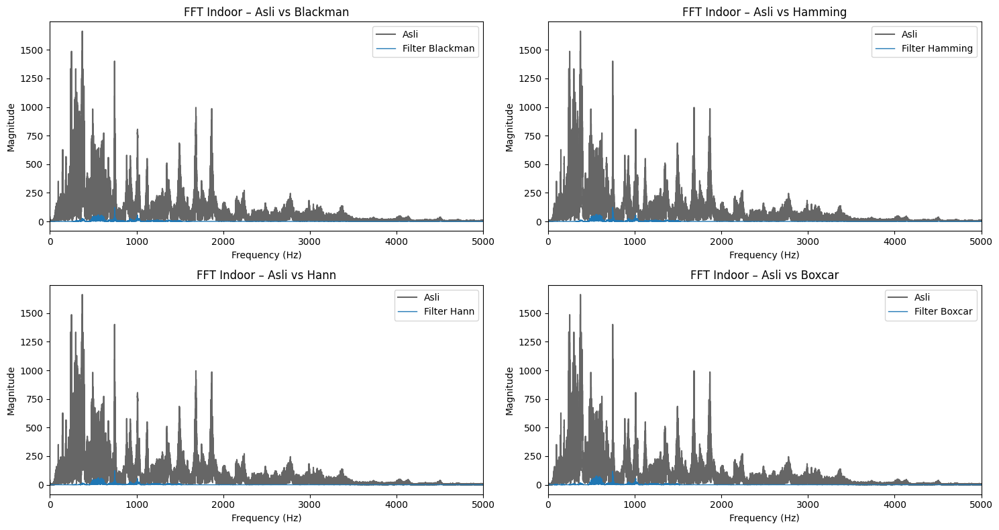

In [ ]:
# FFT INDOOR: Asli vs Filter (2×2)

freq_ori_in, fft_ori_in = compute_fft(audio_in_p, sr_in)

titles = {
    "hamming":  "Hamming",
    "hann":     "Hann",
    "blackman": "Blackman",
    "boxcar":   "Boxcar"
}

plt.figure(figsize=(15,8))

for i, w in enumerate(windows_fir, 1):
    # FFT filter
    freq_filt, fft_filt = compute_fft(filtered_in[w], sr_in)

    plt.subplot(2, 2, i)

    # Suara asli
    plt.plot(freq_ori_in, fft_ori_in,
             label="Asli", color="black", alpha=0.6)

    # Hasil filter
    plt.plot(freq_filt, fft_filt,
             label=f"Filter {titles[w]}", linewidth=1)

    plt.xlim(0, 5000)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.title(f"FFT Indoor – Asli vs {titles[w]}")
    plt.legend()

plt.tight_layout()
plt.show()


Perbandingan FFT sinyal indoor asli dan sinyal hasil filtering FIR menunjukkan bahwa penggunaan window Hamming dan Hann memberikan keseimbangan terbaik antara peredaman noise dan pelestarian komponen frekuensi utama. Window Blackman menghasilkan peredaman noise paling agresif, sedangkan window Boxcar menunjukkan performa paling rendah akibat kebocoran frekuensi yang lebih besar.

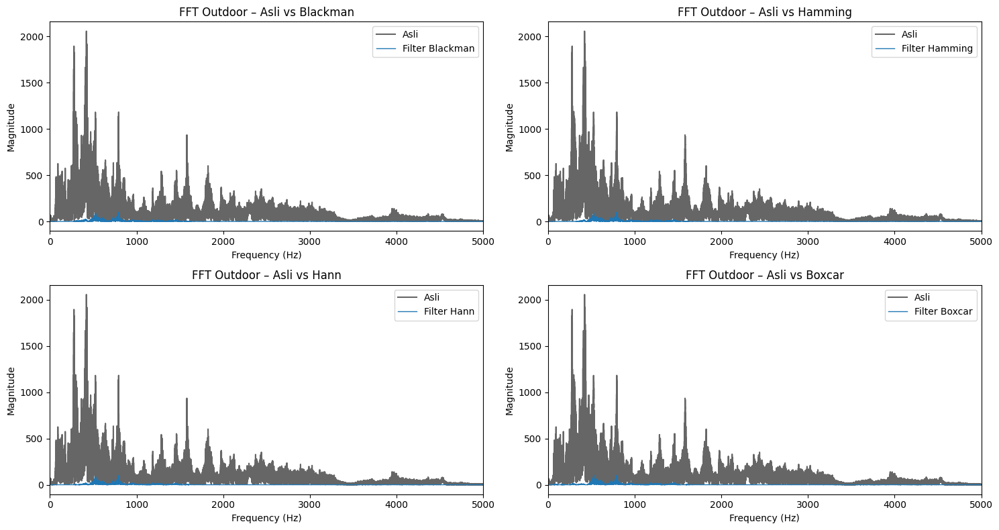

In [ ]:
# FFT OUTDOOR: Asli vs Filter (2×2)

freq_ori_out, fft_ori_out = compute_fft(audio_out_p, sr_out)

plt.figure(figsize=(15,8))

for i, w in enumerate(windows_fir, 1):
    freq_filt, fft_filt = compute_fft(filtered_out[w], sr_out)

    plt.subplot(2, 2, i)

    # Suara asli
    plt.plot(freq_ori_out, fft_ori_out,
             label="Asli", color="black", alpha=0.6)

    # Filtered
    plt.plot(freq_filt, fft_filt,
             label=f"Filter {titles[w]}", linewidth=1)

    plt.xlim(0, 5000)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.title(f"FFT Outdoor – Asli vs {titles[w]}")
    plt.legend()

plt.tight_layout()
plt.show()


Perbandingan FFT sinyal outdoor asli dan sinyal hasil filtering FIR menunjukkan bahwa seluruh window menghasilkan spektrum dengan magnitudo yang sangat rendah. Hal ini mengindikasikan bahwa sinyal outdoor tidak memiliki komponen frekuensi dominan pada rentang 500–1500 Hz, sehingga filtering bandpass kurang efektif untuk mempertahankan informasi sinyal.

DETEKSI FREKUENSI DOMINAN

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def dominant_frequency_plot(signal, sr, title,
                            f_min=0, f_max=5000):
    """
    Deteksi frekuensi dominan + plot FFT
    """
    # FFT
    fft_vals = np.abs(np.fft.rfft(signal))
    freqs = np.fft.rfftfreq(len(signal), 1/sr)

    # Batasi frekuensi
    mask = (freqs >= f_min) & (freqs <= f_max)
    freqs_sel = freqs[mask]
    fft_sel = fft_vals[mask]

    # Frekuensi dominan
    dom_freq = freqs_sel[np.argmax(fft_sel)]

    # Plot
    plt.figure(figsize=(12,5))
    plt.plot(freqs, fft_vals, label="FFT Spectrum")
    plt.axvline(dom_freq, color='red', linestyle='--',
                label=f'Dominant = {dom_freq:.2f} Hz')

    plt.xlim(f_min, f_max)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

    return dom_freq


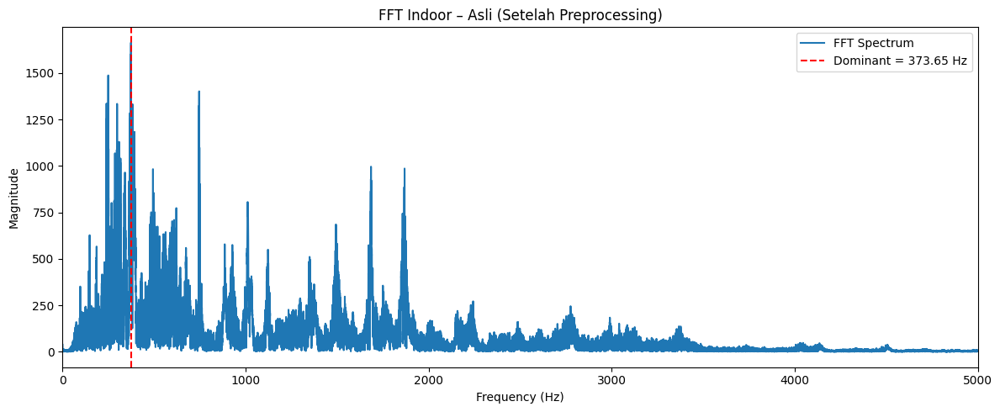

Frekuensi dominan Indoor (asli): 373.65 Hz


In [ ]:
#Audio Asli (Setelah Preprocessing)
dom_freq_indoor = dominant_frequency_plot(
    audio_in_p, sr_in,
    title="FFT Indoor – Asli (Setelah Preprocessing)",
    f_min=0, f_max=5000
)

print(f"Frekuensi dominan Indoor (asli): {dom_freq_indoor:.2f} Hz")


Frekuensi dominan audio indoor setelah preprocessing berada pada 373,65 Hz, yang termasuk dalam rentang suara manusia. Hal ini menunjukkan bahwa sinyal utama masih terjaga

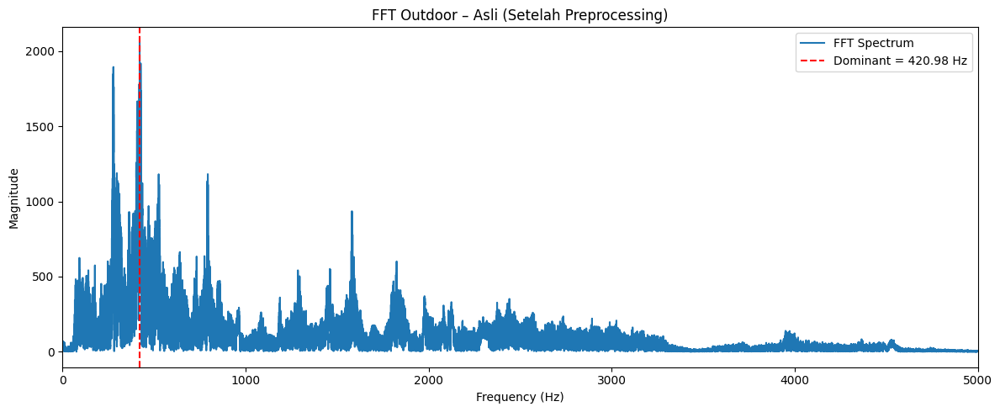

Frekuensi dominan Outdoor (asli): 420.98 Hz


In [ ]:
dom_freq_outdoor = dominant_frequency_plot(
    audio_out_p, sr_out,
    title="FFT Outdoor – Asli (Setelah Preprocessing)",
    f_min=0, f_max=5000
)

print(f"Frekuensi dominan Outdoor (asli): {dom_freq_outdoor:.2f} Hz")


Frekuensi dominan audio outdoor setelah preprocessing terdeteksi pada 420,98 Hz, namun tidak menunjukkan dominasi yang kuat akibat pengaruh noise lingkungan

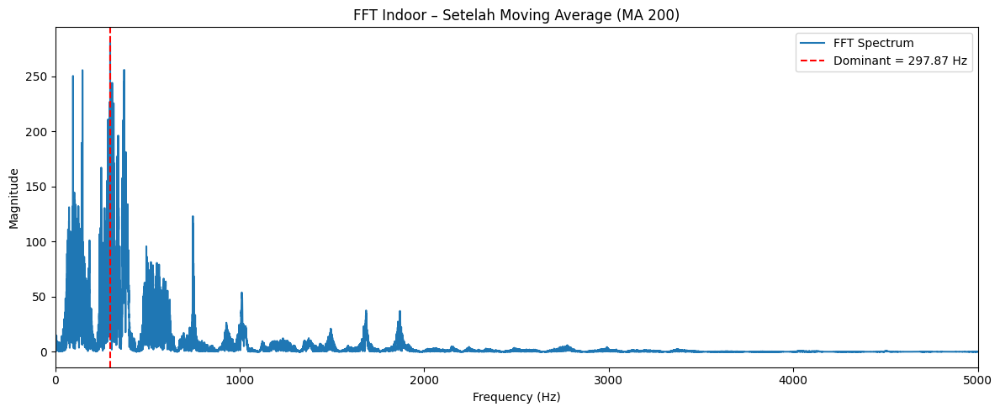

Frekuensi dominan Indoor (MA 200): 297.87 Hz


In [ ]:
#Setelah Moving Average (MA 200)
dom_freq_in_ma = dominant_frequency_plot(
    den_in, sr_in,
    title="FFT Indoor – Setelah Moving Average (MA 200)",
    f_min=0, f_max=5000
)

print(f"Frekuensi dominan Indoor (MA 200): {dom_freq_in_ma:.2f} Hz")


Setelah penerapan moving average (MA 200), spektrum FFT audio indoor menjadi lebih halus dengan frekuensi dominan bergeser ke 297,87 Hz, menunjukkan bahwa MA 200 efektif dalam meredam noise tanpa menghilangkan komponen utama sinyal suara.

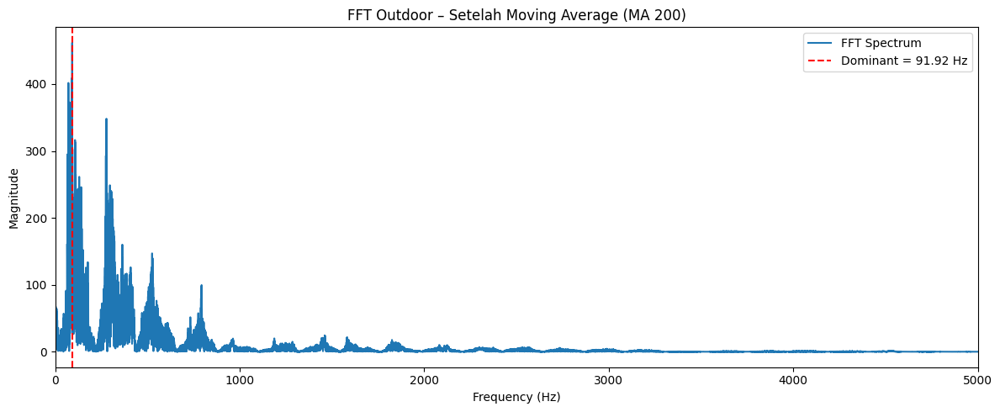

Frekuensi dominan Outdoor (MA 200): 91.92 Hz


In [ ]:
dom_freq_out_ma = dominant_frequency_plot(
    den_out, sr_out,
    title="FFT Outdoor – Setelah Moving Average (MA 200)",
    f_min=0, f_max=5000
)

print(f"Frekuensi dominan Outdoor (MA 200): {dom_freq_out_ma:.2f} Hz")


Setelah penerapan moving average (MA 200), frekuensi dominan audio outdoor bergeser ke 91,92 Hz yang merepresentasikan noise frekuensi rendah, sehingga MA 200 kurang efektif untuk mengekstraksi komponen suara utama pada sinyal outdoor.

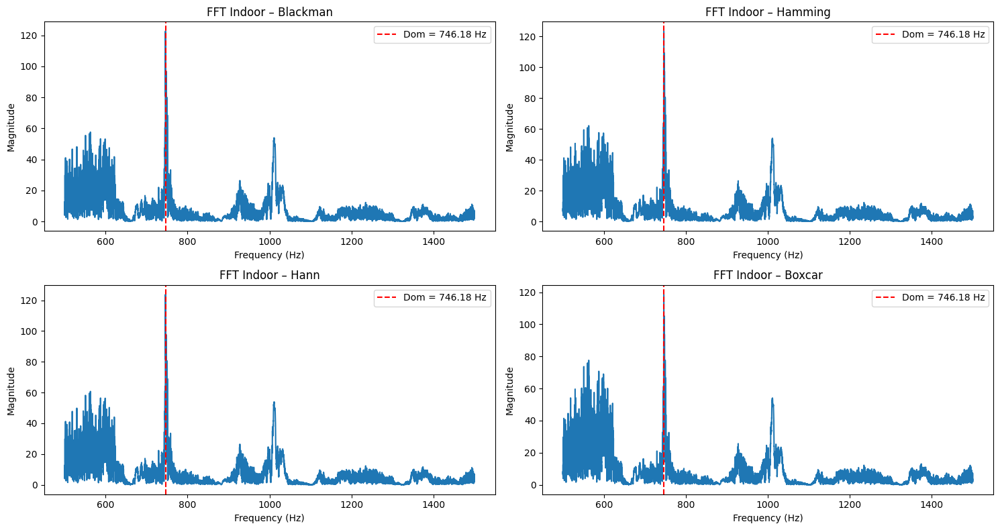

In [ ]:
#FFT Setelah FIR Filter (Per Window)
titles = {
    "blackman": "Blackman",
    "hamming": "Hamming",
    "hann": "Hann",
    "boxcar": "Boxcar"
}

plt.figure(figsize=(15,8))

for i, w in enumerate(windows_fir, 1):
    # FFT
    fft_vals = np.abs(np.fft.rfft(filtered_in[w]))
    freqs = np.fft.rfftfreq(len(filtered_in[w]), 1/sr_in)

    # Fokus 500–1500 Hz
    mask = (freqs >= 500) & (freqs <= 1500)
    freqs_sel = freqs[mask]
    fft_sel = fft_vals[mask]

    # Frekuensi dominan
    dom_freq = freqs_sel[np.argmax(fft_sel)]

    # Plot
    plt.subplot(2, 2, i)
    plt.plot(freqs_sel, fft_sel)
    plt.axvline(dom_freq, color='red', linestyle='--',
                label=f'Dom = {dom_freq:.2f} Hz')

    plt.title(f"FFT Indoor – {titles[w]}")
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.legend()

plt.tight_layout()
plt.show()



Filtering FIR bandpass pada sinyal audio indoor berhasil menghasilkan frekuensi dominan yang konsisten di sekitar 746,18 Hz untuk seluruh jenis window. Window Hamming dan Hann memberikan hasil paling seimbang antara peredaman noise dan pelestarian sinyal, sedangkan Blackman lebih agresif dan Boxcar menunjukkan kebocoran frekuensi yang lebih besar.

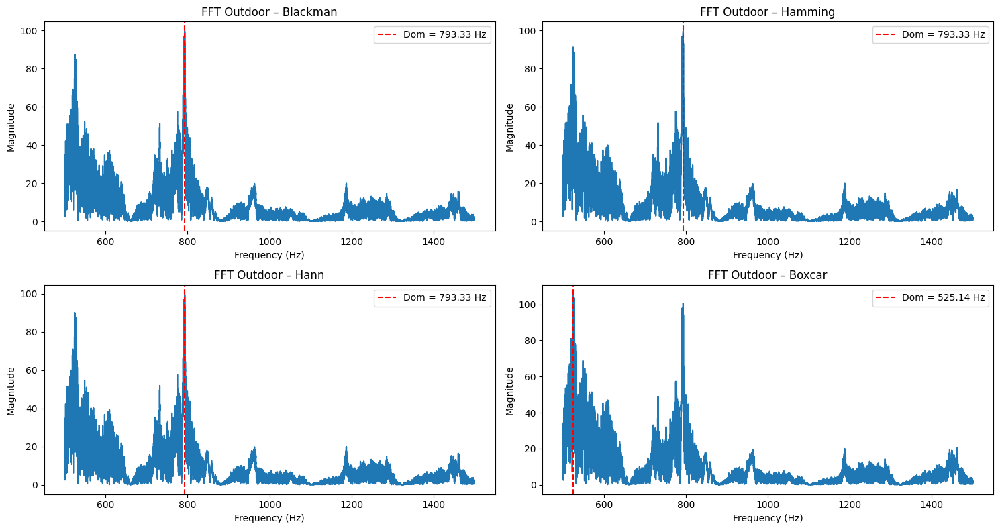

In [ ]:
plt.figure(figsize=(15,8))

for i, w in enumerate(windows_fir, 1):
    # FFT
    fft_vals = np.abs(np.fft.rfft(filtered_out[w]))
    freqs = np.fft.rfftfreq(len(filtered_out[w]), 1/sr_out)

    # Fokus 500–1500 Hz
    mask = (freqs >= 500) & (freqs <= 1500)
    freqs_sel = freqs[mask]
    fft_sel = fft_vals[mask]

    # Frekuensi dominan
    dom_freq = freqs_sel[np.argmax(fft_sel)]

    # Plot
    plt.subplot(2, 2, i)
    plt.plot(freqs_sel, fft_sel)
    plt.axvline(dom_freq, color='red', linestyle='--',
                label=f'Dom = {dom_freq:.2f} Hz')

    plt.title(f"FFT Outdoor – {titles[w]}")
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.legend()

plt.tight_layout()
plt.show()


Filtering FIR bandpass pada sinyal audio outdoor mampu menonjolkan komponen frekuensi tertentu, namun kestabilan frekuensi dominan sangat bergantung pada jenis window. Window Hamming dan Hann memberikan hasil paling konsisten, sedangkan Boxcar menunjukkan performa paling rendah akibat kebocoran frekuensi yang tinggi.

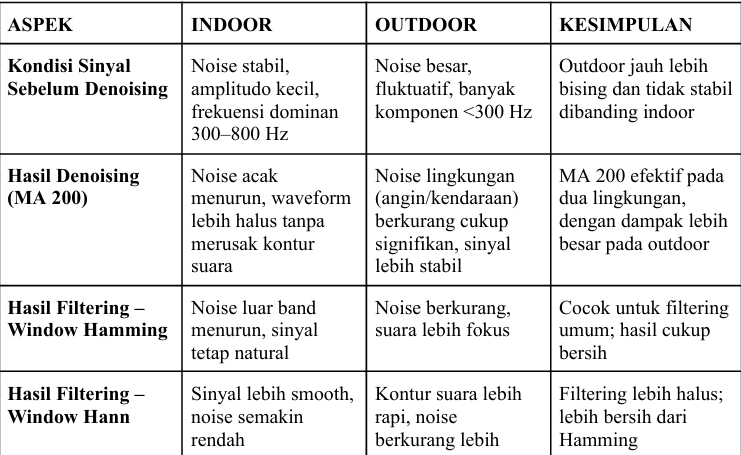

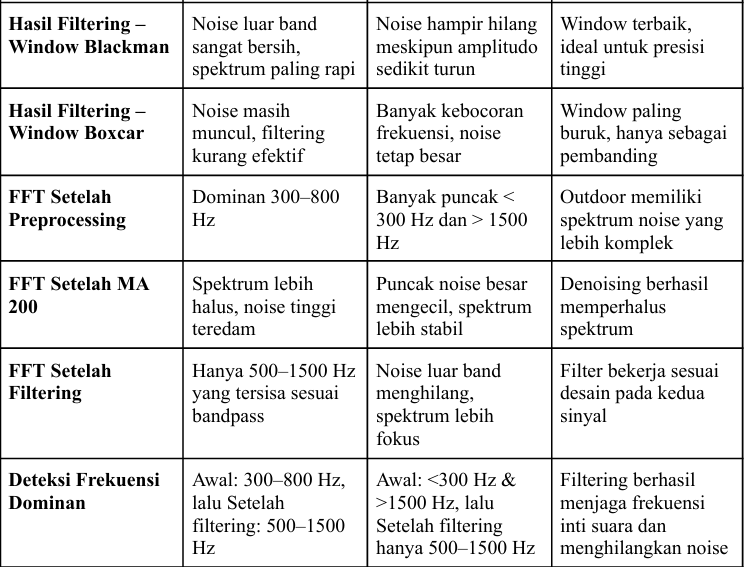